- 数据读取
- QC
- 数据标准化
- 特征选择-->选择高变基因2000
- 数据归一化
- 找出bulk data和ST data的common gene
- 数据降维
- 空间坐标可视化
- cluster marker gene

In [1]:
import warnings
warnings.filterwarnings('ignore')
import numpy as np
import pandas as pd
import scanpy as sc
import matplotlib.pyplot as plt
# import scvelo as scv
import seaborn as sns
import warnings
sc.settings.verbosity = 3  # verbosity: errors (0), warnings (1), info (2), hints (3)
sc.logging.print_header()
sc.settings.set_figure_params(dpi=300, facecolor='white')

scanpy==1.9.6 anndata==0.10.3 umap==0.5.5 numpy==1.26.2 scipy==1.11.4 pandas==2.1.4 scikit-learn==1.3.2 statsmodels==0.14.1 igraph==0.11.3 pynndescent==0.5.11


In [7]:
outdir = "./lung_data/"
cancer = "Lung"

In [8]:
#数据读取
adata = sc.read_visium(
    path='./Spatial Cancer/'+cancer+"/",
    library_id=cancer,
    count_file='CytAssist_FFPE_Human_Lung_Squamous_Cell_Carcinoma_filtered_feature_bc_matrix.h5')
adata.obs_names_make_unique()
adata.var_names_make_unique()

reading Spatial Cancer\Lung\CytAssist_FFPE_Human_Lung_Squamous_Cell_Carcinoma_filtered_feature_bc_matrix.h5
 (0:00:00)


In [9]:
adata.to_df()

,SAMD11,NOC2L,KLHL17,PLEKHN1,PERM1,HES4,ISG15,AGRN,RNF223,C1orf159,...,MT-ND2,MT-CO2,MT-ATP6,MT-CO3,MT-ND3,MT-ND4L,MT-ND4,MT-ND5,MT-ND6,MT-CYB
AACACGTGCATCGCAC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,3.0,0.0,0.0,1.0,2.0,0.0,0.0,0.0,0.0
AACACTTGGCAAGGAA-1,0.0,1.0,0.0,0.0,0.0,0.0,3.0,2.0,0.0,0.0,...,23.0,24.0,18.0,37.0,8.0,31.0,36.0,9.0,26.0,30.0
AACAGGATTCATAGTT-1,0.0,0.0,0.0,0.0,0.0,3.0,1.0,5.0,0.0,1.0,...,10.0,11.0,19.0,14.0,6.0,12.0,13.0,9.0,11.0,8.0
AACAGGTTATTGCACC-1,0.0,0.0,0.0,0.0,0.0,0.0,0.0,4.0,0.0,0.0,...,44.0,63.0,53.0,81.0,13.0,70.0,91.0,18.0,24.0,26.0
AACAGGTTCACCGAAG-1,0.0,0.0,0.0,0.0,0.0,2.0,1.0,2.0,0.0,0.0,...,10.0,9.0,7.0,14.0,5.0,17.0,9.0,10.0,11.0,12.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
TGTTGGAACCTTCCGC-1,0.0,1.0,0.0,0.0,0.0,1.0,1.0,5.0,0.0,0.0,...,19.0,20.0,25.0,32.0,9.0,21.0,22.0,9.0,21.0,26.0
TGTTGGAACGAGGTCA-1,0.0,4.0,0.0,2.0,0.0,1.0,3.0,12.0,0.0,0.0,...,54.0,152.0,77.0,170.0,20.0,167.0,160.0,32.0,57.0,63.0
TGTTGGAAGCTCGGTA-1,0.0,0.0,0.0,0.0,0.0,0.0,1.0,3.0,0.0,0.0,...,8.0,5.0,17.0,12.0,13.0,16.0,17.0,9.0,2.0,7.0
TGTTGGATGGACTTCT-1,0.0,1.0,0.0,0.0,0.0,1.0,0.0,3.0,0.0,1.0,...,13.0,15.0,15.0,31.0,8.0,34.0,26.0,3.0,21.0,16.0


In [10]:
# 进行基因计数和添加到 adata.obs 中
def QC(adata):
    sc.pp.calculate_qc_metrics(adata, inplace=True)
    warnings.filterwarnings("ignore", "is_categorical_dtype")
    warnings.filterwarnings("ignore", "use_inf_as_na")
    sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts'], jitter=0.4, multi_panel=True)
    
    fig, axs = plt.subplots(1, 4, figsize=(20, 5))
    pd.option_context('mode.use_inf_as_na', True)
    sns.histplot(adata.obs["total_counts"], kde=False, ax=axs[0])
    sns.histplot(adata.obs["total_counts"][adata.obs["total_counts"] < 80000],
                 kde=False,
                 bins=40,
                 ax=axs[1])
    sns.histplot(adata.obs["n_genes_by_counts"], kde=False, bins=60, ax=axs[2])
    sns.histplot(
        adata.obs["n_genes_by_counts"][adata.obs["n_genes_by_counts"] < 2000],
        kde=False,
        bins=60,
        ax=axs[3])
    plt.savefig(outdir+"images/counts.jpg")

def QC_filter(adata,min_counts,max_counts):
    sc.pp.filter_cells(adata, min_counts=min_counts)
    sc.pp.filter_cells(adata, max_counts=max_counts)
    print(f"#cells after filter: {adata.n_obs}")
    sc.pp.filter_genes(adata, min_cells=10)

#标准化
def Standard(adata):
    sc.pp.normalize_total(adata, inplace=True)
    sc.pp.log1p(adata)

#识别高变基因
def Select_highly(adata):
    sc.pp.highly_variable_genes(adata, flavor="seurat", n_top_genes=2000)
    sc.pl.highly_variable_genes(adata)
    #只保留高变基因
    adata.raw = adata
    adata = adata[:,adata.var.highly_variable]
    return adata

基于总的counts与基因，对spots进行一些基本的过滤：

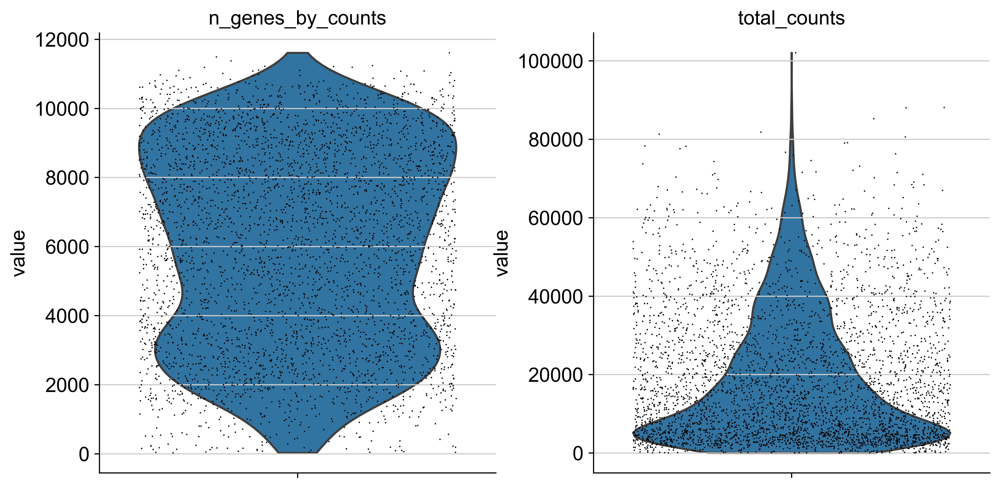

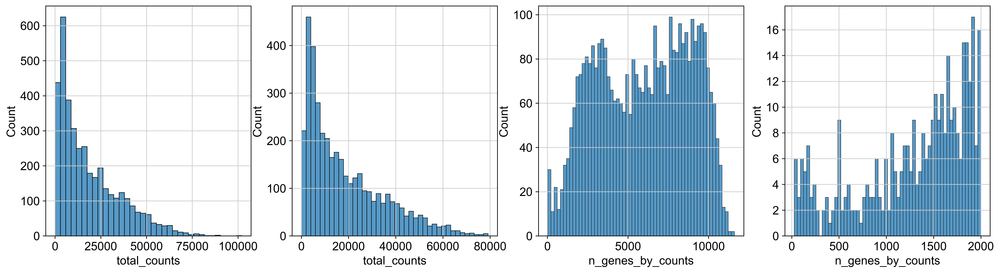

In [11]:
QC(adata)

In [12]:
QC_filter(adata,0,65000)

filtered out 50 cells that have more than 65000 counts
#cells after filter: 3808
filtered out 46 genes that are detected in less than 10 cells


normalizing counts per cell
    finished (0:00:00)
If you pass `n_top_genes`, all cutoffs are ignored.
extracting highly variable genes
    finished (0:00:00)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


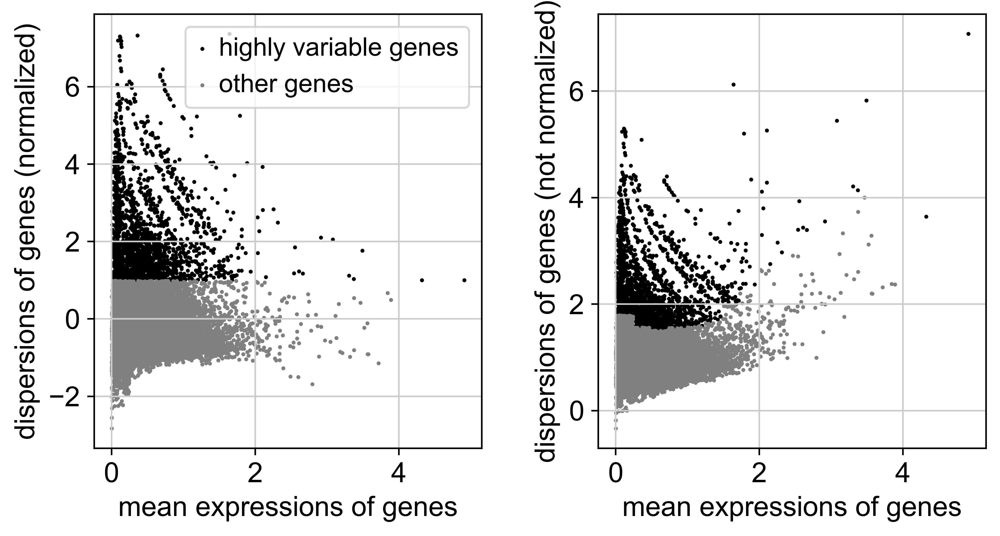

... as `zero_center=True`, sparse input is densified and may lead to large memory consumption


In [13]:
#数据标准化
Standard(adata)
adata = Select_highly(adata)
#数据归一化
sc.pp.scale(adata,max_value=10)

## 找出bulk data和ST data的common mRNA miRNA,进行排序和整合，导出csv

In [14]:
tcga_mrna = pd.read_csv('./tcga_cancers/mrna/tcga_mrna_LUSC.csv',index_col=0).T
tcga_mirna = pd.read_csv('./tcga_cancers/mirna/tcga_mirna_LUSC.csv',index_col=0).T
ccle_mrna = pd.read_csv('./ccle_cancers/mrna/ccle_mrna_LUNG.csv',index_col=0).T
ccle_mirna = pd.read_csv('./ccle_cancers/mirna/ccle_mirna_LUNG.csv',index_col=0).T
# adata = sc.read_h5ad('./ovarian_data/Ovarian.h5ad')

In [15]:
#找出bulk data和ST data的common gene,进行排序和整合
def Save_ranked_mrna(tcga_mrna,ccle_mrna,adata):
    # 删除重复的行索引
    dup_index = ccle_mrna.columns.duplicated()
    ccle_mrna = ccle_mrna.loc[:,~dup_index]
    dup_index = tcga_mrna.columns.duplicated()
    tcga_mrna = tcga_mrna.loc[:,~dup_index]
    #选择共同基因
    tcga_gene = tcga_mrna.columns
    ccle_gene = ccle_mrna.columns
    st_gene = adata.var_names
    common_gene1 =list(set(tcga_gene).intersection(st_gene))
    common_gene = list(set(common_gene1).intersection(ccle_gene))
    #保存有common gene的tcga mrna表达数据
    com_tcga_data = tcga_mrna[common_gene]
    # # 对每一行进行排名
    ranked_tcga_mrna = com_tcga_data.rank(axis=1, ascending=True, method='min')
    ranked_tcga_mirna = tcga_mirna.rank(axis=1, ascending=True, method='min')
    
    #保存有common gene的ccle mrna表达数据
    com_ccle_data = ccle_mrna[common_gene]
    # # 对每一行进行排名
    ranked_ccle_mrna = com_ccle_data.rank(axis=1, ascending=True, method='min')
    ranked_ccle_mirna = ccle_mirna.rank(axis=1, ascending=True, method='min')
    
    #将按列tcga和ccle的数据合并，保存
    ranked_tcga_ccle_mrna = pd.concat([ranked_tcga_mrna,ranked_ccle_mrna])
    ranked_tcga_ccle_mrna.to_csv(outdir+cancer+"ranked_tcga_ccle_mrna.csv")

    #保存有common gene的ST表达数据
    st_exp = adata.to_df()
    st_exp = st_exp[common_gene]
    st_exp.to_csv(outdir+cancer+'st_mrna.csv')

def Save_ranked_mirna(tcga_mirna,ccle_mirna):
    # 删除重复的行索引
    dup_index = ccle_mirna.columns.duplicated()
    ccle_mirna = ccle_mirna.loc[:,~dup_index]
    dup_index = tcga_mirna.columns.duplicated()
    tcga_mirna = tcga_mirna.loc[:,~dup_index]
    #处理miRNA的名称，把p去掉
    ccle_mirna.columns = ccle_mirna.columns.str.replace(r'-\d+p$', '', regex=True)
    # 去重并以平均值替换
    ccle_mirna = ccle_mirna.groupby(ccle_mirna.columns, axis=1).mean()
    #处理miRNA的名称，把p去掉
    tcga_mirna.columns = tcga_mirna.columns.str.replace(r'-\d+p$', '', regex=True)
    # 去重并以平均值替换
    tcga_mirna = tcga_mirna.groupby(tcga_mirna.columns, axis=1).mean()
    # 删除重复的行索引
    dup_index = ccle_mirna.columns.duplicated()
    ccle_mirna = ccle_mirna.loc[:,~dup_index]
    dup_index = tcga_mirna.columns.duplicated()
    tcga_mirna = tcga_mirna.loc[:,~dup_index]
    #处理miRNA的名称，把p去掉
    ccle_mirna.columns = ccle_mirna.columns.str.replace(r'-\d+p$', '', regex=True)
    # 去重并以平均值替换
    ccle_mirna = ccle_mirna.groupby(ccle_mirna.columns, axis=1).mean()
    #处理miRNA的名称，把p去掉
    tcga_mirna.columns = tcga_mirna.columns.str.replace(r'-\d+p$', '', regex=True)
    # 去重并以平均值替换
    tcga_mirna = tcga_mirna.groupby(tcga_mirna.columns, axis=1).mean()
    
    #选择共同基因
    tcga_gene = tcga_mirna.columns
    ccle_gene = ccle_mirna.columns
    common_gene =list(set(tcga_gene).intersection(ccle_gene))
    #保存有common gene的tcga mrna表达数据
    com_tcga_data = tcga_mirna[common_gene]
    # # 对每一行进行排名
    ranked_tcga_mirna = com_tcga_data.rank(axis=1, ascending=True, method='min')
    
    #保存有common gene的ccle mrna表达数据
    com_ccle_data = ccle_mirna[common_gene]
    # # 对每一行进行排名
    ranked_ccle_mirna = com_ccle_data.rank(axis=1, ascending=True, method='min')
    
    #将按列tcga和ccle的数据合并，保存
    ranked_tcga_ccle_mirna = pd.concat([ranked_tcga_mirna,ranked_ccle_mirna])
    ranked_tcga_ccle_mirna.to_csv(outdir+cancer+"ranked_tcga_ccle_mirna.csv")

In [16]:
# Save_ranked_mrna(tcga_mrna,ccle_mrna,adata)
# Save_ranked_mirna(tcga_mirna,ccle_mirna)

## 数据降维

In [17]:
def Spatial_analyze(adata):
    # pca降维，主成分为50
    warnings.filterwarnings("ignore",  category=FutureWarning)
    warnings.filterwarnings("ignore",  category=UserWarning)
    
    sc.tl.pca(adata,svd_solver='arpack',n_comps=50)
    sc.pl.pca_variance_ratio(adata,log=True)
    
    # 构建邻域网络图
    sc.pp.neighbors(adata,n_neighbors=10,n_pcs=40)
    # UMAP&tsne降维，计算出来的都是坐标值
    # t-SNE和UMAP是另外两种非线性的降维方法
    sc.tl.umap(adata)
    sc.tl.tsne(adata,n_pcs=40)
    
    # leiden算法聚类
    sc.tl.leiden(adata, key_added="clusters")
    #保存ST 聚类信息文件
    adata.write(outdir+cancer+'_mrna.h5ad')
    
    fig, ax = plt.subplots(figsize=(6, 6), dpi=300)
    sc.pl.umap(adata,
        color="clusters",use_raw=False,legend_loc='on data',legend_fontsize=8,
       ax=ax
    )
    
    plt.rcParams["figure.figsize"] = (6, 6)
    sc.pl.spatial(adata,
                  img_key="hires",
                  color=["total_counts", "n_genes_by_counts"])
    
    sc.pl.spatial(adata, img_key="hires", color="clusters", size=1.5)
    
    #提取降维后的数据-->主成分为50
    # comp = pd.DataFrame(adata.obsm['X_pca'],index=adata.obs_names)
    # comp = comp.T
    # comp.to_csv('FRspatial_breast.csv')

computing PCA
    on highly variable genes
    with n_comps=50
    finished (0:00:00)


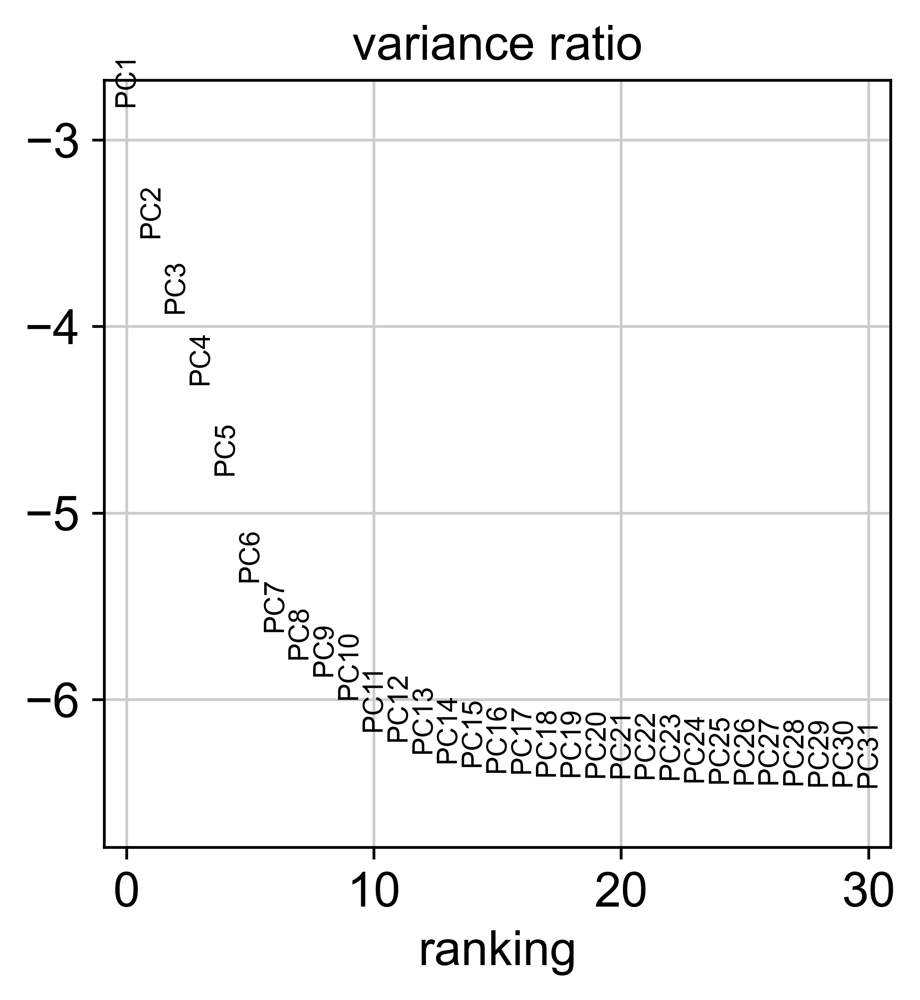

computing neighbors
    using 'X_pca' with n_pcs = 40
    finished: added to `.uns['neighbors']`
    `.obsp['distances']`, distances for each pair of neighbors
    `.obsp['connectivities']`, weighted adjacency matrix (0:00:02)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:00:06)
computing tSNE
    using 'X_pca' with n_pcs = 40
    using sklearn.manifold.TSNE
    finished: added
    'X_tsne', tSNE coordinates (adata.obsm) (0:00:09)
running Leiden clustering
    finished: found 12 clusters and added
    'clusters', the cluster labels (adata.obs, categorical) (0:00:00)


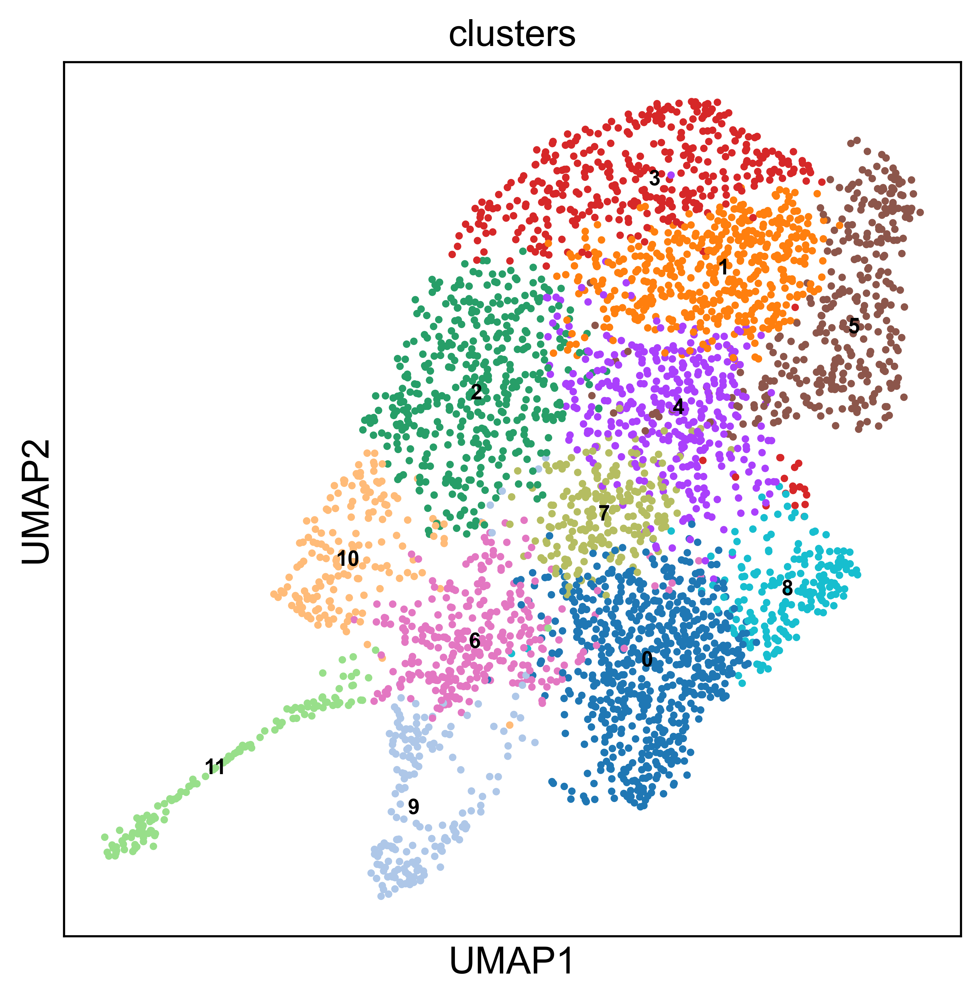

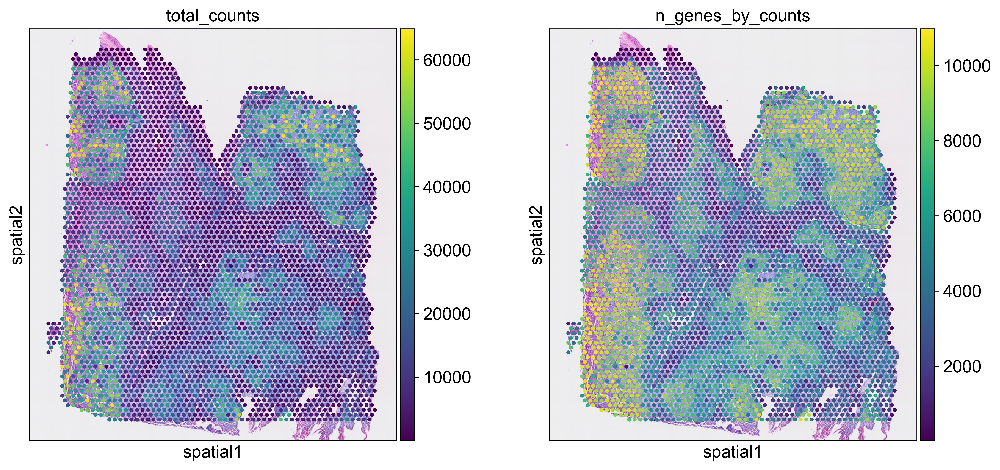

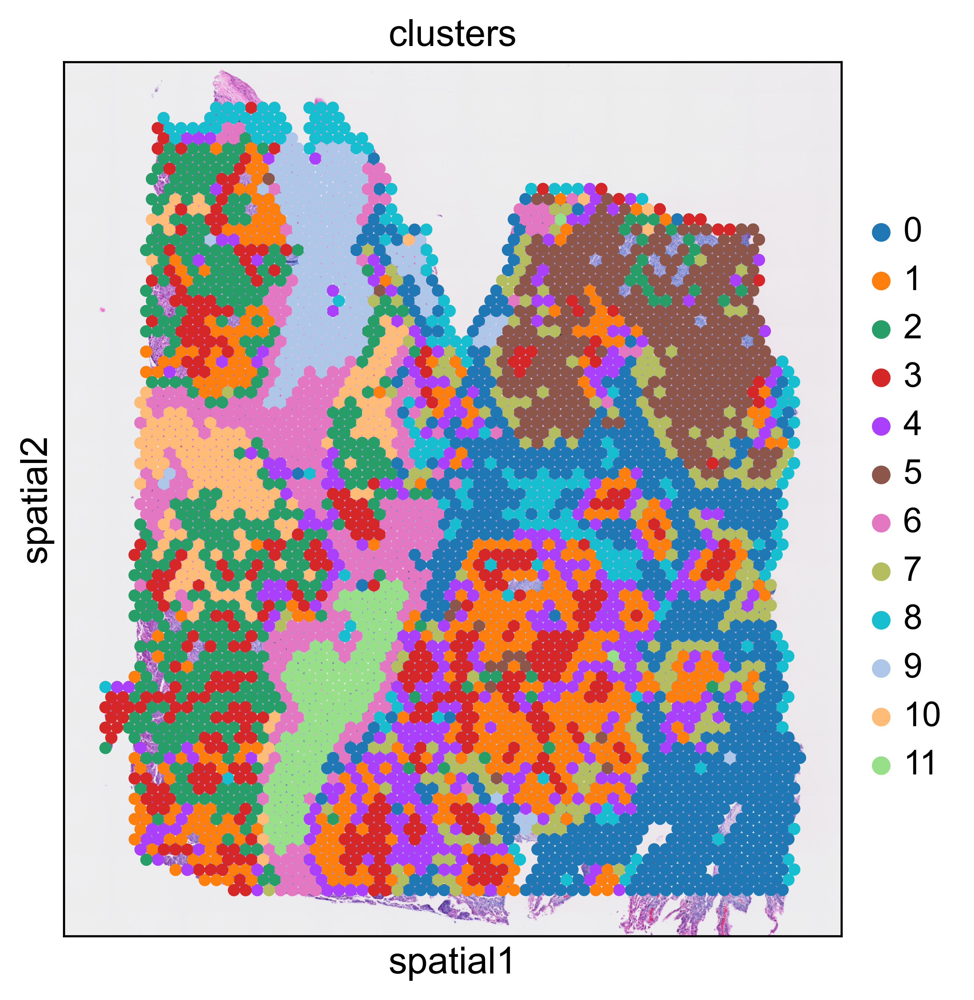

In [18]:
Spatial_analyze(adata)

通过在空间维度上可视化聚集样本，可以深入了解组织的组织结构，并有可能进入细胞间通讯

## spatial cluster marker genes

进一步观察集群2，它出现在图像中的小群spots中。  
计算标记基因并绘制热图，其中包含前10个标记基因在整个cluster中的表达水平:

ranking genes
    finished: added to `.uns['rank_genes_groups']`
    'names', sorted np.recarray to be indexed by group ids
    'scores', sorted np.recarray to be indexed by group ids
    'logfoldchanges', sorted np.recarray to be indexed by group ids
    'pvals', sorted np.recarray to be indexed by group ids
    'pvals_adj', sorted np.recarray to be indexed by group ids (0:00:02)
    using 'X_pca' with n_pcs = 50
Storing dendrogram info using `.uns['dendrogram_clusters']`
categories: 0, 1, 2, etc.
var_group_labels: 2


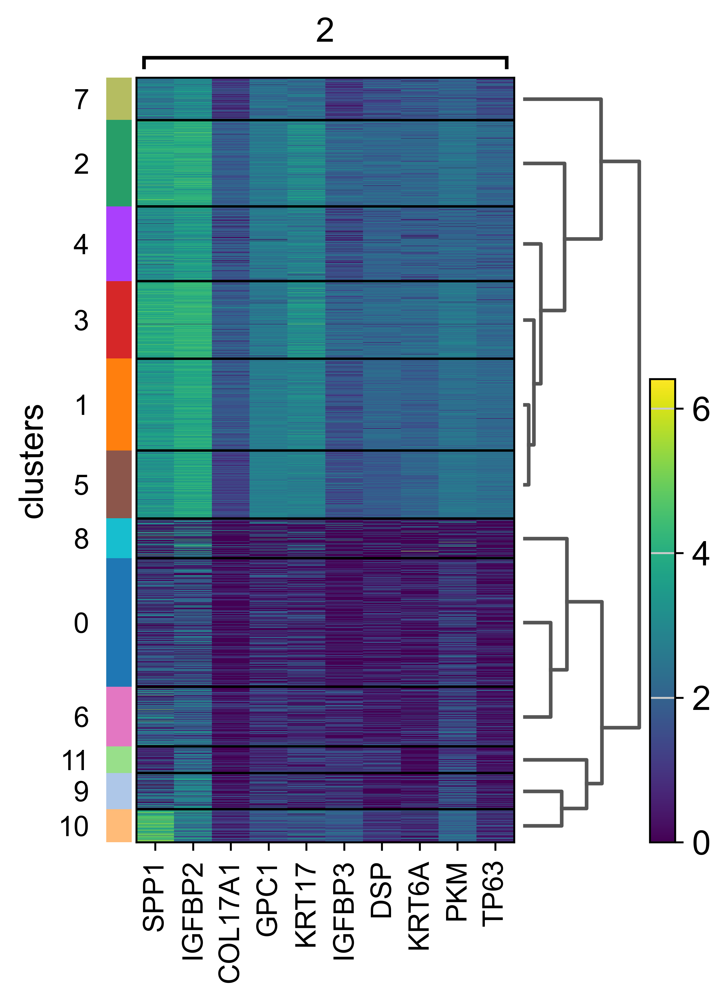

In [19]:
sc.tl.rank_genes_groups(adata, "clusters", method="t-test")
sc.pl.rank_genes_groups_heatmap(adata, groups="2", n_genes=10, groupby="clusters")